# Make postISRCCD from raw for Spectractor StandAlone


- work with Weakly_2023_35


- author : Sylvie Dagoret-Campagne
- affiliation : IJCLab
- creation date : 2023/09/13
- last update : 2023/09/28



write output file according hierarchy

         filter/DATE


In [1]:
! eups list -s | grep LOCAL

analysis_tools        LOCAL:/home/d/dagoret/repos/repos_w_2023_35/analysis_tools 	setup
atmospec              LOCAL:/home/d/dagoret/repos/repos_w_2023_35/atmospec 	setup
eups                  LOCAL:/opt/lsst/software/stack/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe-7.0.1/eups 	setup
spectractor           LOCAL:/home/d/dagoret/repos/repos_w_2023_35/Spectractor 	setup


In [2]:
! echo $IMAGE_DESCRIPTION
! eups list -s lsst_distrib

Weekly 2023_35
   g4213664e8e+c55b99ec95 	current w_2023_35 setup


In [3]:
import os
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cm as cmx
import matplotlib.dates as mdates

import numpy as np
import pandas as pd
%matplotlib inline
from matplotlib.colors import LogNorm

from mpl_toolkits.axes_grid1 import make_axes_locatable

import matplotlib.ticker                         # here's where the formatter is
from matplotlib.ticker import (MultipleLocator, FormatStrFormatter,
                               AutoMinorLocator)

from astropy.visualization import (MinMaxInterval, SqrtStretch,ZScaleInterval,PercentileInterval,
                                   ImageNormalize,imshow_norm)
from astropy.visualization.stretch import SinhStretch, LinearStretch,AsinhStretch,LogStretch


from astropy.io import fits




In [4]:
# Assembly task
# https://github.com/lsst/ip_isr/blob/main/python/lsst/ip/isr/isrTask.py

from lsst.ip.isr.assembleCcdTask import (AssembleCcdConfig, AssembleCcdTask)
from lsst.ip.isr.isrTask import (IsrTask, IsrTaskConfig)

#https://github.com/lsst/ip_isr/blob/main/python/lsst/ip/isr/overscan.py
from lsst.ip.isr import  OverscanCorrectionTaskConfig, OverscanCorrectionTask

In [5]:
# LSST Display
import lsst.afw.display as afwDisplay
afwDisplay.setDefaultBackend('matplotlib')

In [6]:
import lsst.daf.butler as dafButler

In [7]:
import warnings
warnings.filterwarnings("ignore")

# Configuration

In [8]:
FLAG_PLOT=True

In [9]:
#DATE = 20230117
#FILTER="empty-holo4_003"
#FILTER="BG40_65mm_1-holo4_003"
#FILTER="OG550_65mm_1-holo4_003"

#DATE = 20230118
#FILTER = "BG40_65mm_1-holo4_003"
#FILTER = "OG550_65mm_1-holo4_003"
#FILTER = "empty-holo4_003"

#DATE = 20230119
#FILTER="empty-holo4_003"
#FILTER="BG40_65mm_1-holo4_003"
#FILTER="OG550_65mm_1-holo4_003"

#DATE = 20230131
#FILTER = "empty-holo4_003"
#FILTER="BG40_65mm_1-holo4_003"
#FILTER="OG550_65mm_1-holo4_003"


#DATE = 20230201
#FILTER = "empty-holo4_003"
#FILTER="BG40_65mm_1-holo4_003"
#FILTER="OG550_65mm_1-holo4_003"


#DATE = 20230202
#FILTER = "empty-holo4_003"
#FILTER="BG40_65mm_1-holo4_003"
#FILTER="OG550_65mm_1-holo4_003"

#DATE = 20230215
#FILTER="empty-holo4_003"


#DATE = 20230315
#FILTER="empty-holo4_003"

#DATE = 20230316
#FILTER="empty-holo4_003"

#DATE = 20230704
#FILTER = "empty-holo4_003"

#DATE = 20230705
#FILTER = "empty-holo4_003"

#DATE = 20230706
#FILTER = "empty-holo4_003"


#DATE = 20230718
#FILTER = "empty-holo4_003"

#DATE = 20230720
#FILTER = "empty-holo4_003"

#DATE = 20230801
#FILTER = "empty-holo4_003"

#DATE = 20230802
#FILTER = "empty-holo4_003"

#DATE = 20230815
#FILTER = "empty-holo4_003"

#DATE = 20230817
#FILTER = "empty-holo4_003"


#DATE = 20230912
#FILTER="cyl_lens~holo4_001"
#FILTER="cyl_lens~holo4_003"
#FILTER="collimator~holo4_003"
#FILTER="empty~holo4_001"
#FILTER="empty~holo4_003"

#DATE = 20230913
#FILTER="collimator~holo4_003"
#FILTER="cyl_lens~holo4_003"
#FILTER="empty~holo4_003"
#FILTER="empty~holo4_001"

#DATE = 20230914
#FILTER="collimator~holo4_003"
#FILTER="cyl_lens~holo4_003"
#FILTER="empty~holo4_003"
#FILTER="empty~holo4_001"


#DATE = 20230926
#FILTER="cyl_lens~holo4_003"
#FILTER="empty~holo4_003"

DATE = 20230927
#FILTER="cyl_lens~holo4_003"
FILTER="empty~holo4_003"


#DATE = 20230927
#FILTER="cyl_lens~holo4_003"
#FILTER="empty~holo4_003"


#filename_visits = f"visitdispersers_{DATE}_filt_{FILTER}.list"
filename_visits = f"all_visitdispersers/{DATE}/visitdispersers_{DATE}_filt_{FILTER}.list"

In [10]:
# output path of type top/date/filter
#----------------------------------------

top_path_out="my_postisrccd_img"
path_out=f"{top_path_out}/{FILTER}"

In [11]:
if not os.path.exists(path_out):
    os.makedirs(path_out)

In [12]:
path_out=f"{path_out}/{DATE}"

if not os.path.exists(path_out):
    os.makedirs(path_out)

# read list of exposures

- generated by ListOfExposures-hologram.ipynb

In [13]:
df = pd.read_csv(filename_visits, header=None,skiprows = 1, sep=' ',names=["date","seq"])
df

,date,seq
0,20230927,217
1,20230927,218
2,20230927,219
3,20230927,220
4,20230927,221
...,...,...
73,20230927,471
74,20230927,478
75,20230927,479
76,20230927,504


In [14]:
! ls all_visitdispersers/20230926/

visitdispersers_20230926_filt_empty~holo4_003.list


In [15]:
for index,row in df.iterrows():
    exposure_selected =row["date"]*100000+row["seq"]
    print(exposure_selected)

2023092700217
2023092700218
2023092700219
2023092700220
2023092700221
2023092700222
2023092700223
2023092700224
2023092700225
2023092700226
2023092700227
2023092700228
2023092700229
2023092700230
2023092700231
2023092700232
2023092700233
2023092700234
2023092700235
2023092700236
2023092700237
2023092700238
2023092700239
2023092700240
2023092700241
2023092700242
2023092700243
2023092700244
2023092700245
2023092700246
2023092700282
2023092700283
2023092700290
2023092700291
2023092700298
2023092700299
2023092700309
2023092700310
2023092700318
2023092700319
2023092700326
2023092700327
2023092700334
2023092700335
2023092700342
2023092700343
2023092700350
2023092700351
2023092700358
2023092700359
2023092700382
2023092700383
2023092700390
2023092700391
2023092700398
2023092700399
2023092700406
2023092700407
2023092700414
2023092700415
2023092700422
2023092700423
2023092700430
2023092700431
2023092700438
2023092700439
2023092700446
2023092700447
2023092700454
2023092700455
2023092700462
202309

## Select flags options

In [16]:
FLAG_ROTATE_IMG = True
FLAG_TRANSFORM = True

## Transformations
astropy scale transformations

In [17]:
transform = AsinhStretch() + PercentileInterval(99.)
#transform = PercentileInterval(98.)

## Butler

In [18]:
#repo = '/sdf/group/rubin/repo/main'
repo="/sdf/group/rubin/repo/oga/"
butler = dafButler.Butler(repo)
registry = butler.registry

In [19]:
collection='LATISS/raw/all'

In [20]:
# configuration
isr_config =  IsrTaskConfig()

In [21]:
isr_config.doDark = False
isr_config.doFlat =  False
isr_config.doFringe = False
isr_config.doDefect = True
isr_config.doLinearize = False
isr_config.doCrosstalk =  False
isr_config.doSaturationInterpolation = False
isr_config.overscan.fitType: 'MEDIAN_PER_ROW'
isr_config.doBias: True


In [22]:
isr_task = IsrTask(config=isr_config)

In [23]:
###########################################
# REPO=/repo/embargo
# butler query-collections $REPO LATISS/calib
#############################################

In [24]:
calibType = 'bias'
physical_filter = 'empty~empty'
cameraName = 'LATISS'
# Collection name containing the verification outputs.
calibCollections = ['LATISS/calib','LATISS/raw/all',]                   

In [25]:
butler = dafButler.Butler(repo, collections=calibCollections)
camera = butler.get('camera', instrument=cameraName)
#bias = butler.get('bias',instrument=cameraName,detector=0)
#defects = butler.get('defects',instrument=cameraName,detector=0)


Exposure 2023092700217, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700217, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700218, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700218, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700219, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700219, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700220, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700220, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700221, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700221, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700222, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700222, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700223, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700223, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700224, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700224, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700225, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700225, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700226, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700226, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700227, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700227, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700228, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700228, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700229, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700229, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700230, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700230, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700231, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700231, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700232, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700232, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700233, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700233, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700234, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700234, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700235, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700235, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700236, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700236, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700237, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700237, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700238, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700238, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700239, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700239, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700240, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700240, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700241, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700241, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700242, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700242, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700243, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700243, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700244, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700244, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700245, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700245, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700246, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700246, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700282, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700282, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700283, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700283, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700290, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700290, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700291, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700291, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700298, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700298, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700299, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700299, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700309, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700309, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700310, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700310, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700318, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700318, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700319, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700319, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700326, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700326, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700327, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700327, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700334, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700334, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700335, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700335, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700342, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700342, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700343, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700343, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700350, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700350, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700351, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700351, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700358, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700358, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700359, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700359, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700382, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700382, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700383, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700383, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700390, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700390, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700391, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700391, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700398, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700398, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700399, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700399, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700406, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700406, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700407, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700407, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700414, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700414, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700415, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700415, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700422, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700422, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700423, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700423, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700430, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700430, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700431, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700431, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700438, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700438, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700439, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700439, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700446, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700446, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700447, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700447, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700454, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700454, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700455, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700455, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700462, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700462, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700463, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700463, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700470, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700470, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700471, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700471, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700478, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700478, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700479, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700479, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700504, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700504, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023092700505, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023092700505, DATE for Master Defect with short calib list 2022-06-08 17:35:34


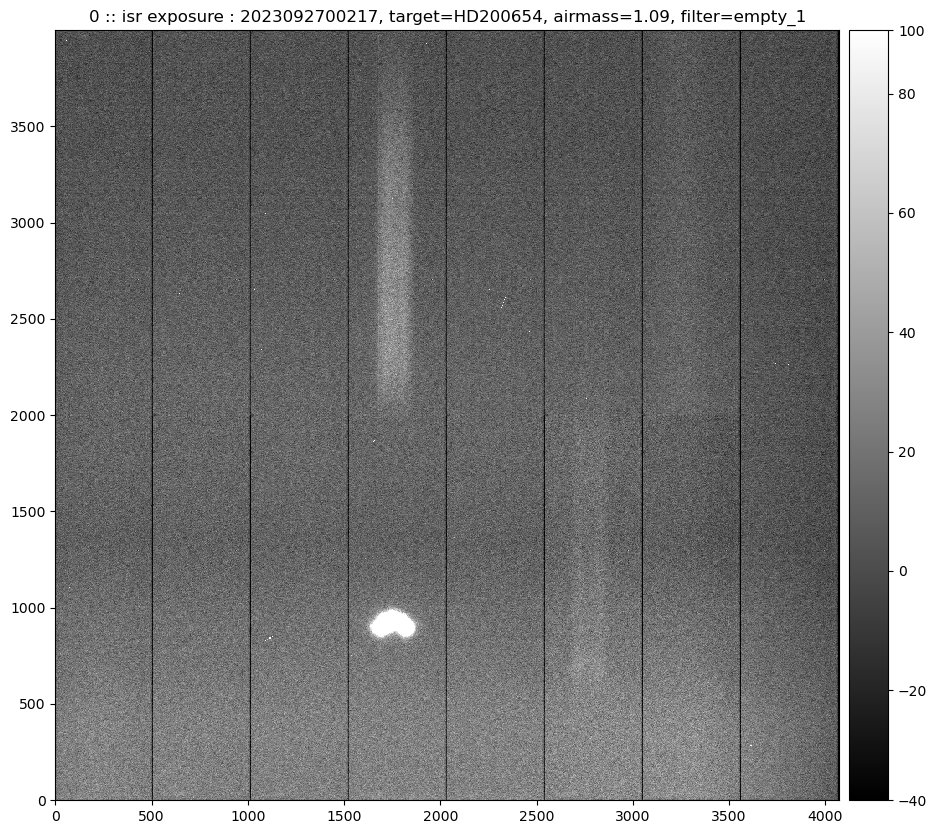

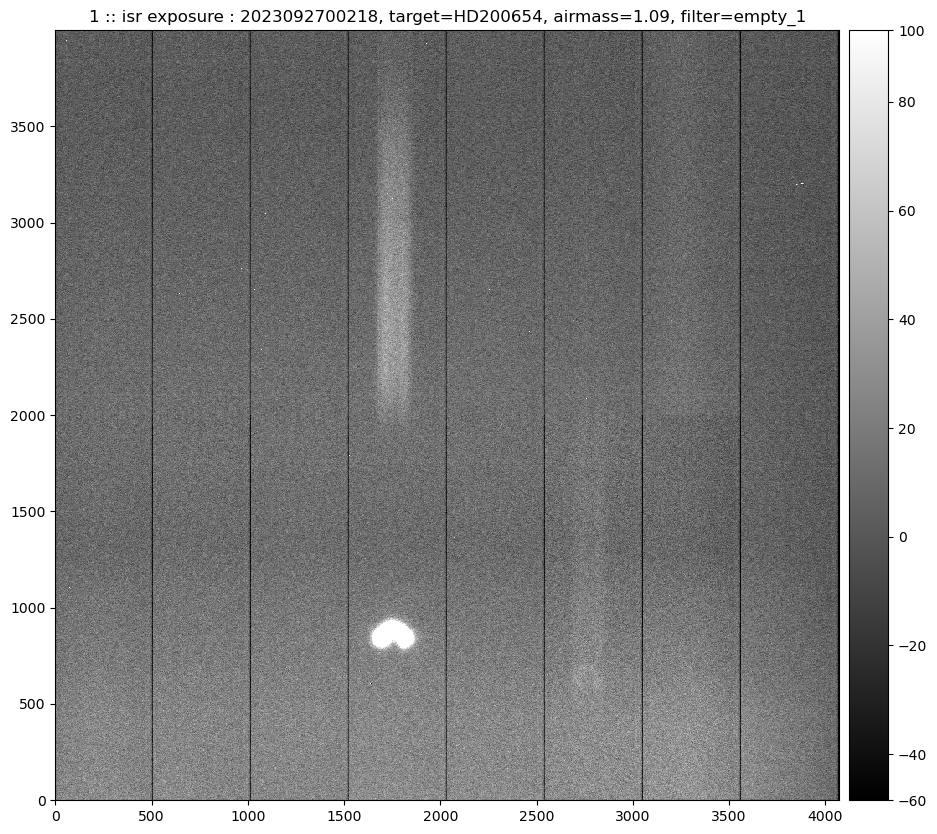

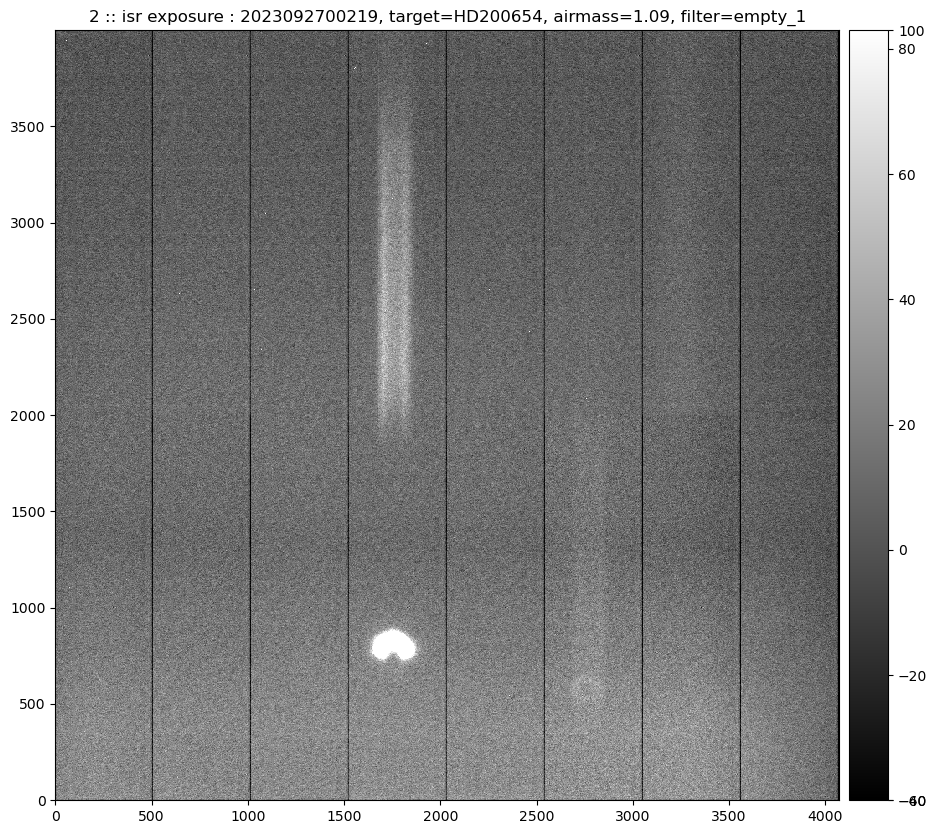

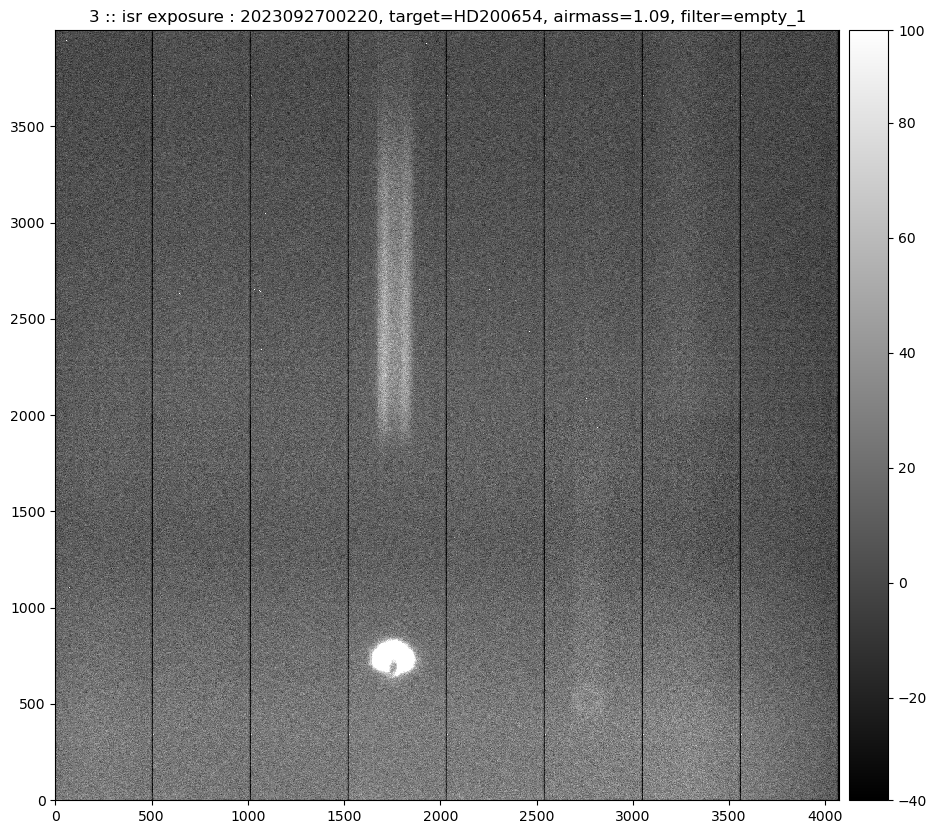

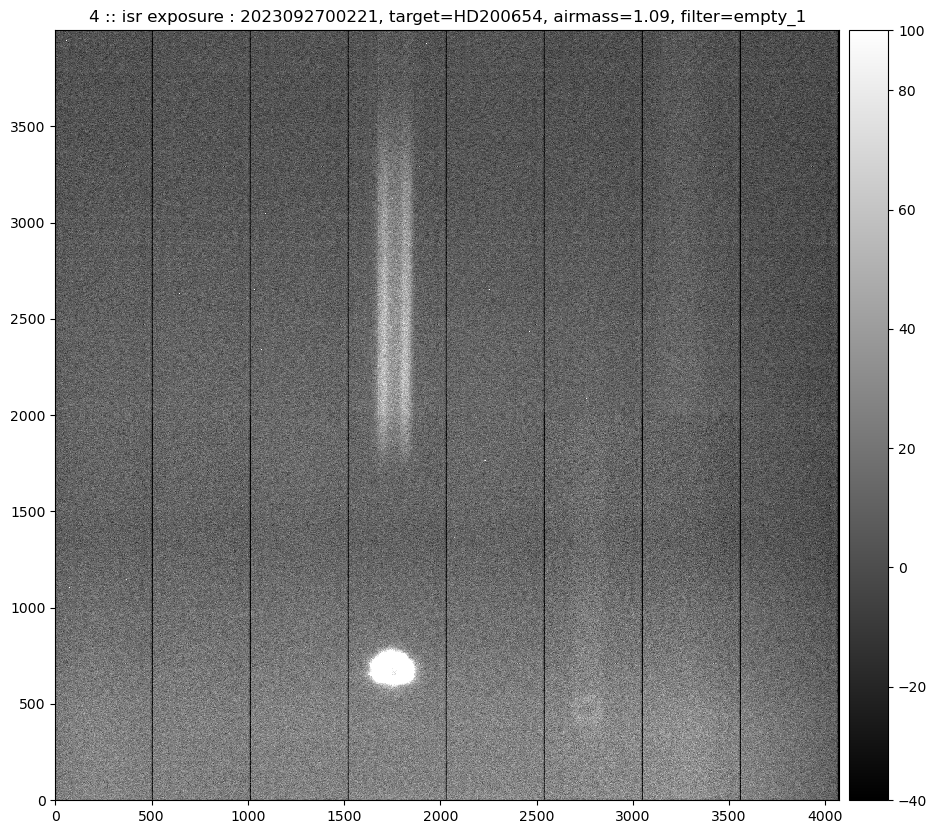

...

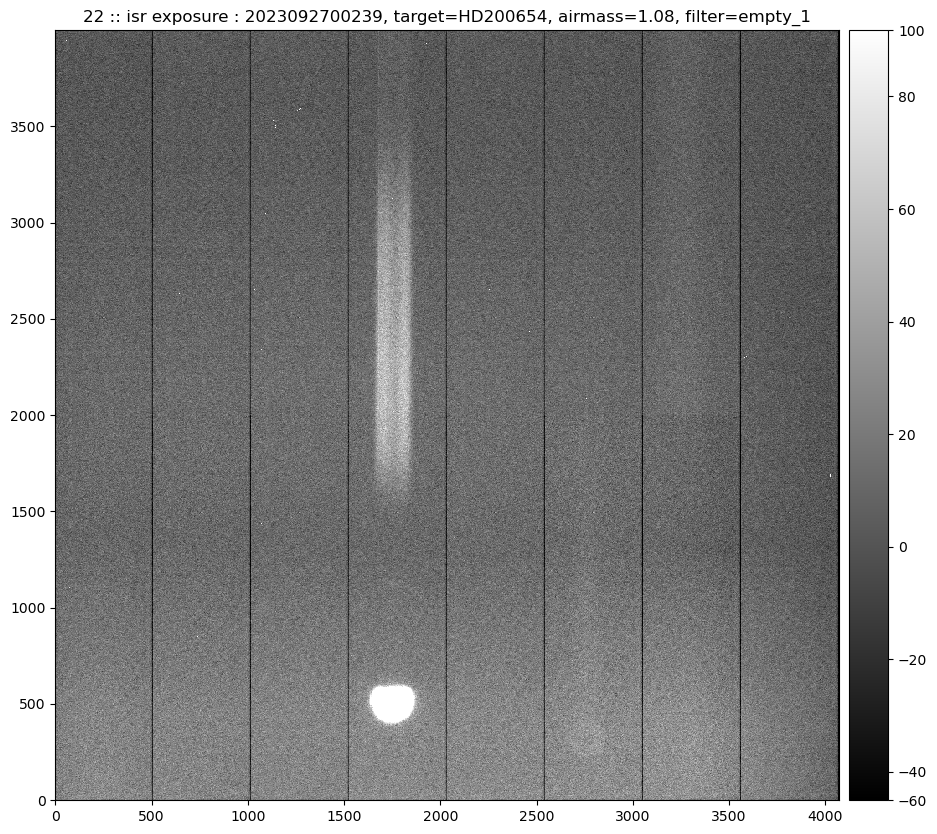

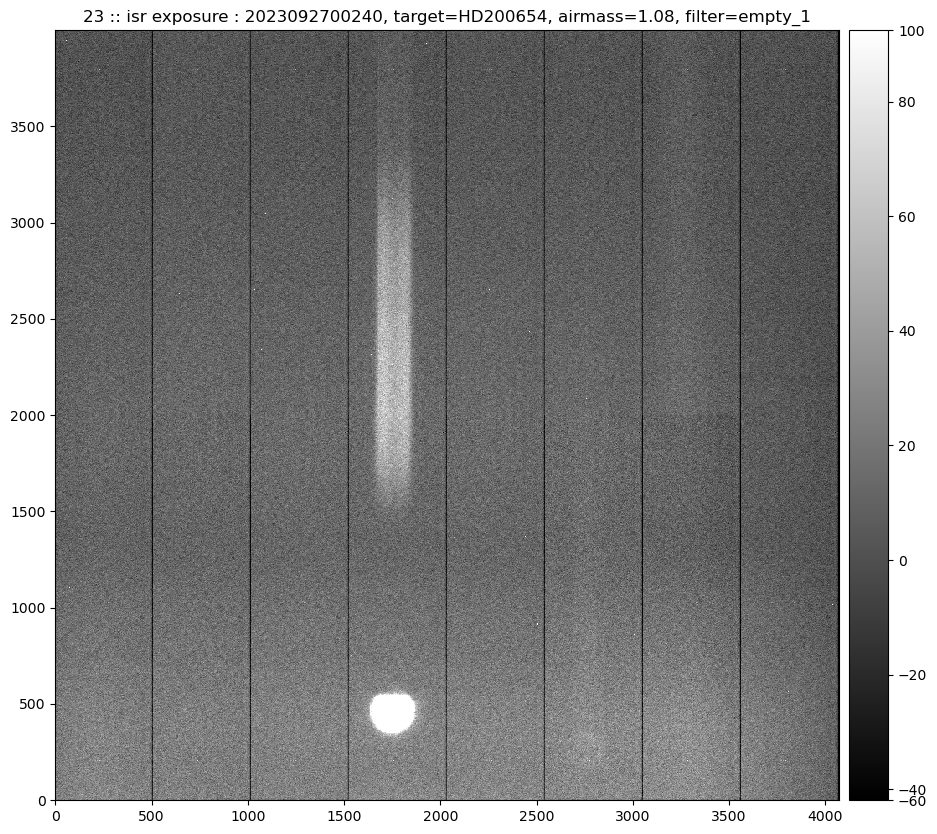

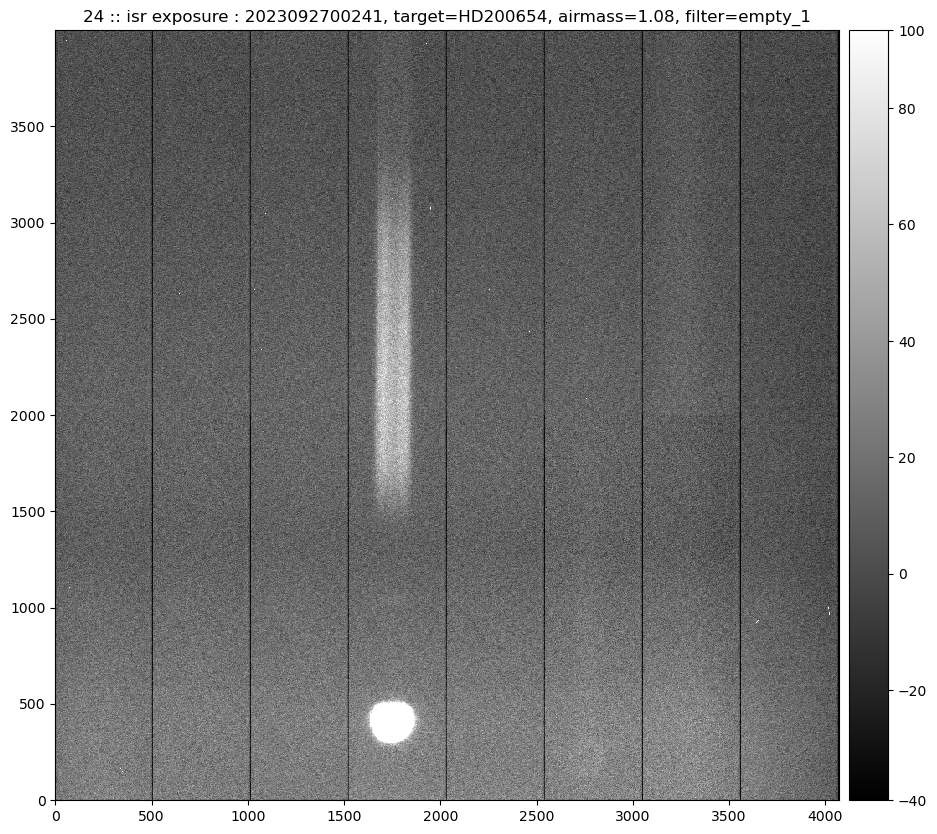

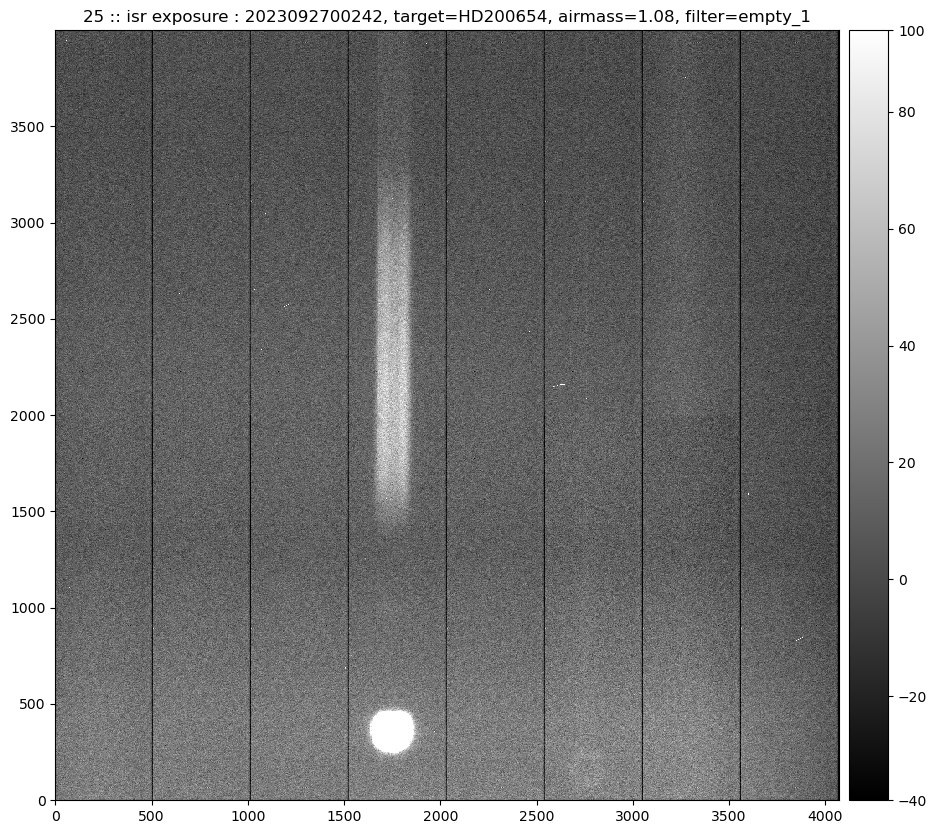

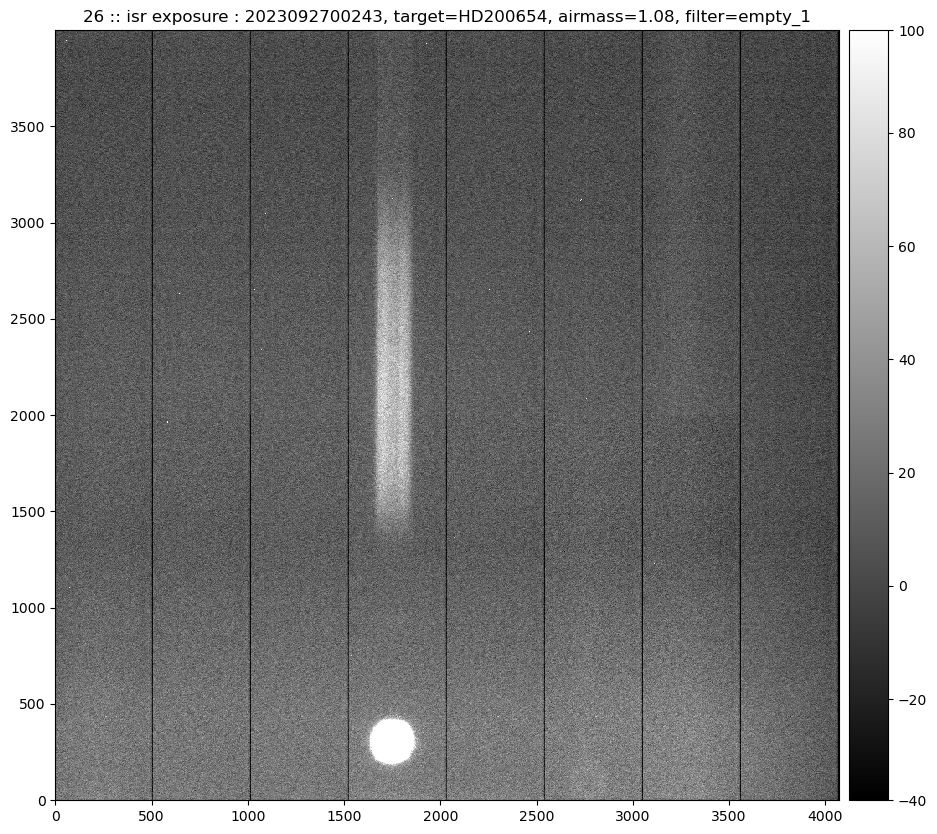

In [ ]:
%matplotlib inline
if FLAG_PLOT:
    for index,row in df.iterrows():
        exposure_selected =row["date"]*100000+row["seq"]



        raw_img= butler.get('raw', dataId={'exposure': exposure_selected, 'instrument': 'LATISS', 'detector': 0}, collections = collection)
        bias = butler.get("bias",instrument=cameraName, exposure= exposure_selected , detector=0, collections=calibCollections)
        defects = butler.get('defects',instrument=cameraName, exposure= exposure_selected ,detector=0,collections=calibCollections)
    
    
            # get metadata
        bias_md = dict(bias.getMetadata())
        MB_date= bias_md['CALIB_CREATION_DATE']
        MB_time = bias_md['CALIB_CREATION_TIME']
        print(f"Exposure {exposure_selected}, DATE for Master Bias with short calib list",MB_date, MB_time)
    
        defects_md = dict(defects.getMetadata()) 
        DF_date= defects_md['CALIB_CREATION_DATE']
        DF_time = defects_md['CALIB_CREATION_TIME']
        print(f"Exposure {exposure_selected}, DATE for Master Defect with short calib list",DF_date, DF_time)
    
        meta = raw_img.getMetadata()
        md = meta.toDict()
    
        the_object = md['OBJECT']
        
        if the_object == "MU-COL":
            md['OBJECT']="HD38666"
            the_object = md['OBJECT']
            
        if the_object == "ETA1-DOR":
            md['OBJECT']="HD42525"
            the_object = md['OBJECT']
            
            
        the_am= md['AMSTART']
        the_filter=md['FILTER']
    
        #fast ISR 
        isr_img = isr_task.run(raw_img,bias=bias,defects=defects)
    
        rotated_array = isr_img.exposure.image.array[::-1,::-1] #rotate the array 180 degrees
        #np.flip(np.flip(a, 1), 0)

    
        fig = plt.figure(figsize=(12,10))
        afw_display = afwDisplay.Display(frame=fig)
        afw_display.scale('linear', 'zscale',None)
        the_title = f"{index} :: isr exposure : {exposure_selected}, target={the_object}, airmass={the_am:.2f}, filter={the_filter}"
        afw_display.mtv(isr_img.exposure.image,title=the_title)

In [ ]:
# Save in files

In [ ]:
for index,row in df.iterrows():
    
    exposure_selected =row["date"]*100000+row["seq"]
    
    print(f"exposure selected = {exposure_selected}")


    raw_img= butler.get('raw', dataId={'exposure': exposure_selected, 'instrument': 'LATISS', 'detector': 0}, collections = collection)
    bias = butler.get("bias",instrument=cameraName, exposure= exposure_selected , detector=0, collections=calibCollections)
    defects = butler.get('defects',instrument=cameraName, exposure= exposure_selected ,detector=0,collections=calibCollections)
    
    
    isr_img = isr_task.run(raw_img,bias=bias,defects=defects)
    
    arr=isr_img.exposure.image.array
    # 180 degree rotation
    rotated_array = arr[::-1,::-1] #rotate the array 180 degrees
    
    
    meta = raw_img.getMetadata()
    md = meta.toDict()

    the_object = md['OBJECT']
    the_am= md['AMSTART']
    the_filter=md['FILTER']
    
    if the_object == "MU-COL":
        md['OBJECT']="HD38666"
        the_object = md['OBJECT']

    filename_out = f"exposure_{exposure_selected}_pseudo-postisrccd.fits"
    fullfilename_out=os.path.join(path_out,filename_out)
    
    print(f">>>>  output filename {filename_out} object {the_object}")
    
    hdr = fits.Header()
    
    for key,value in md.items():
        if key == 'OBJECT':
            print(key,value)
        hdr[str(key)]=value
        
    # need this    
    hdr["AMEND"] = hdr["AMSTART"]
    
    # be aware weather data may be missing
    if hdr["AIRTEMP"] == None:
        hdr["AIRTEMP"] = 10.0

    if hdr["PRESSURE"] == None:
        hdr["PRESSURE"] = 744.

    if hdr["HUMIDITY"] == None:
        hdr["HUMIDITY"] = 50.

    if hdr["WINDSPD"] == None:
        hdr["WINDSPD"] = 5.

    if hdr["WINDDIR"] == None:
        hdr["WINDDIR"] = 0.   

    if hdr["SEEING"] == None:
        hdr["SEEING"] = 1.15
    
        
   
    
    # Be carefull for Spectractor, 2 hdu units are necessary
    
    primary_hdu = fits.PrimaryHDU(header=hdr)
    image_hdu = fits.ImageHDU(rotated_array)
    
    hdu_list = fits.HDUList([primary_hdu, image_hdu])
    
    hdu_list.writeto(fullfilename_out,overwrite=True)
    
    
    
    #if index>=0:
    #    break
    


In [ ]:
print("finished")